
# Ridge operators

Ridge filters can be used to detect ridge-like structures, such as neurites
[1]_, tubes [2]_, vessels [3]_, wrinkles [4]_ or rivers.

Different ridge filters may be suited for detecting different structures,
e.g., depending on contrast or noise level.

The present class of ridge filters relies on the eigenvalues of
the Hessian matrix of image intensities to detect ridge structures where the
intensity changes perpendicular but not along the structure.

## References

.. [1] Meijering, E., Jacob, M., Sarria, J. C., Steiner, P., Hirling, H.,
       Unser, M. (2004). Design and validation of a tool for neurite tracing
       and analysis in fluorescence microscopy images. Cytometry Part A, 58(2),
       167-176.
       :DOI:`10.1002/cyto.a.20022`

.. [2] Sato, Y., Nakajima, S., Shiraga, N., Atsumi, H., Yoshida, S.,
       Koller, T., ..., Kikinis, R. (1998). Three-dimensional multi-scale line
       filter for segmentation and visualization of curvilinear structures in
       medical images. Medical image analysis, 2(2), 143-168.
       :DOI:`10.1016/S1361-8415(98)80009-1`

.. [3] Frangi, A. F., Niessen, W. J., Vincken, K. L., & Viergever, M. A. (1998,
       October). Multiscale vessel enhancement filtering. In International
       Conference on Medical Image Computing and Computer-Assisted Intervention
       (pp. 130-137). Springer Berlin Heidelberg.
       :DOI:`10.1007/BFb0056195`

.. [4] Ng, C. C., Yap, M. H., Costen, N., & Li, B. (2014, November). Automatic
       wrinkle detection using hybrid Hessian filter. In Asian Conference on
       Computer Vision (pp. 609-622). Springer International Publishing.
       :DOI:`10.1007/978-3-319-16811-1_40`


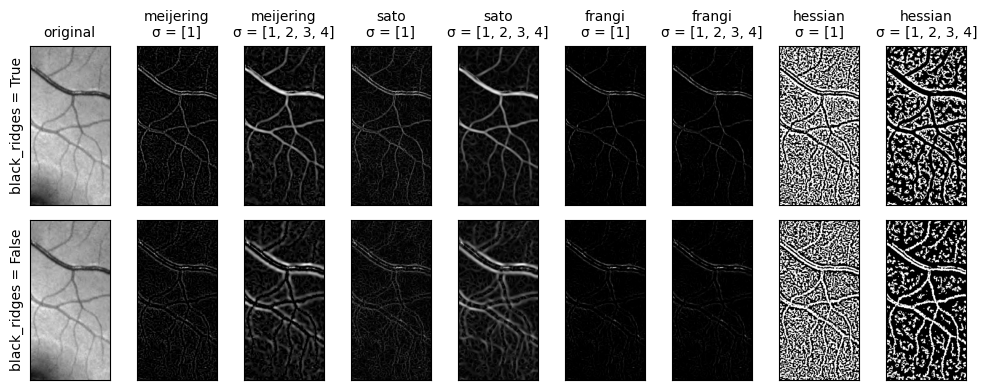

In [1]:
# https://scikit-image.org/docs/stable/auto_examples/edges/plot_ridge_filter.html#sphx-glr-auto-examples-edges-plot-ridge-filter-py


from skimage import data
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt


def original(image, **kwargs):
    """Return the original image, ignoring any kwargs."""
    return image


image = color.rgb2gray(data.retina())[300:700, 700:900]
cmap = plt.cm.gray

plt.rcParams["axes.titlesize"] = "medium"
axes = plt.figure(figsize=(10, 4)).subplots(2, 9)
for i, black_ridges in enumerate([True, False]):
    for j, (func, sigmas) in enumerate([
            (original, None),
            (meijering, [1]),
            (meijering, range(1, 5)),
            (sato, [1]),
            (sato, range(1, 5)),
            (frangi, [1]),
            (frangi, range(1, 5)),
            (hessian, [1]),
            (hessian, range(1, 5)),
    ]):
        result = func(image, black_ridges=black_ridges, sigmas=sigmas)
        axes[i, j].imshow(result, cmap=cmap)
        if i == 0:
            title = func.__name__
            if sigmas:
                title += f"\n\N{GREEK SMALL LETTER SIGMA} = {list(sigmas)}"
            axes[i, j].set_title(title)
        if j == 0:
            axes[i, j].set_ylabel(f'{black_ridges = }')
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()

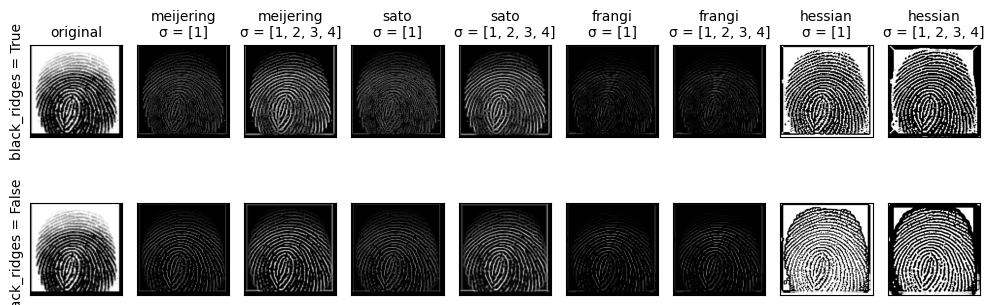

In [12]:
import cv2
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt
from skimage.transform import resize

# Loading fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Resizing the image to reduce its size
resized_image = resize(fingerprint_image, (512, 512), anti_aliasing=True)

def original(image, **kwargs):
    """Return the original image, ignoring any kwargs."""
    return image

cmap = plt.cm.gray

plt.rcParams["axes.titlesize"] = "medium"
axes = plt.figure(figsize=(10, 4)).subplots(2, 9)
for i, black_ridges in enumerate([True, False]):
    for j, (func, sigmas) in enumerate([
            (original, None),
            (meijering, [1]),
            (meijering, range(1, 5)),
            (sato, [1]),
            (sato, range(1, 5)),
            (frangi, [1]),
            (frangi, range(1, 5)),
            (hessian, [1]),
            (hessian, range(1, 5)),
    ]):
        try:
            result = func(resized_image, black_ridges=black_ridges, sigmas=sigmas)
            axes[i, j].imshow(result, cmap=cmap)
            if i == 0:
                title = func.__name__
                if sigmas:
                    title += f"\n\N{GREEK SMALL LETTER SIGMA} = {list(sigmas)}"
                axes[i, j].set_title(title)
            if j == 0:
                axes[i, j].set_ylabel(f'{black_ridges = }')
            axes[i, j].set_xticks([])
            axes[i, j].set_yticks([])
        except ValueError as e:
            print(f"Error: {e}")

plt.tight_layout()
plt.show()


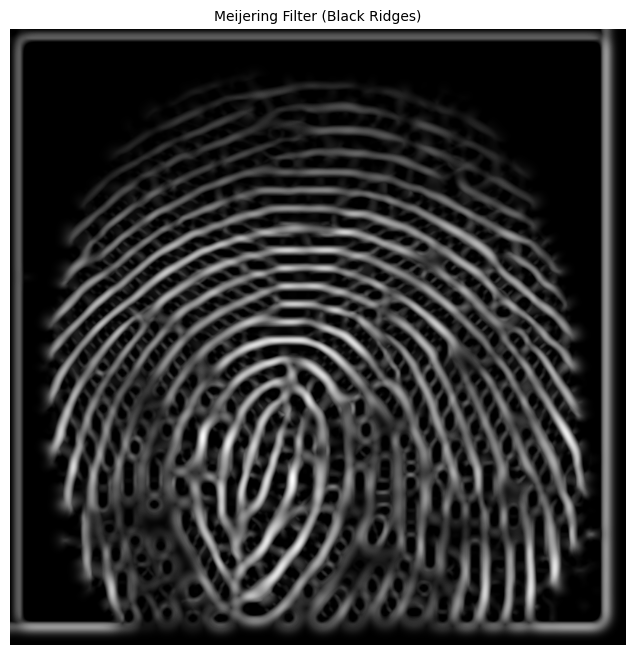

In [18]:
import cv2
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt
from skimage.transform import resize

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Resizing the image to reduce its size
resized_image = resize(fingerprint_image, (1000, 1000), anti_aliasing=False)

# Applying meijering filter with black_ridges=True separately
meijering_result = meijering(resized_image, black_ridges=True)

# Displaying the meijering_result separately
plt.figure(figsize=(8, 8))  # Adjust the figure size
plt.imshow(meijering_result, cmap=plt.cm.gray)
plt.title("Meijering Filter (Black Ridges)")
plt.axis('off')
plt.show()


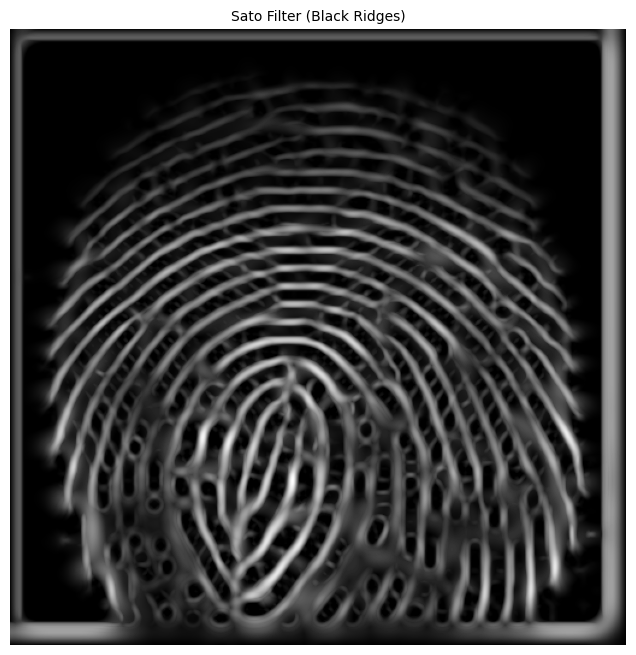

In [19]:
import cv2
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt
from skimage.transform import resize

# Loading fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Resizing the image to reduce its size
resized_image = resize(fingerprint_image, (512, 512), anti_aliasing=True)

# Applying sato filter with black_ridges=True separately
sato_result = sato(resized_image, black_ridges=True)

# Displaying the sato_result separately
plt.figure(figsize=(8, 8))  # Adjust the figure size
plt.imshow(sato_result, cmap=plt.cm.gray)
plt.title("Sato Filter (Black Ridges)")
plt.axis('off')
plt.show()


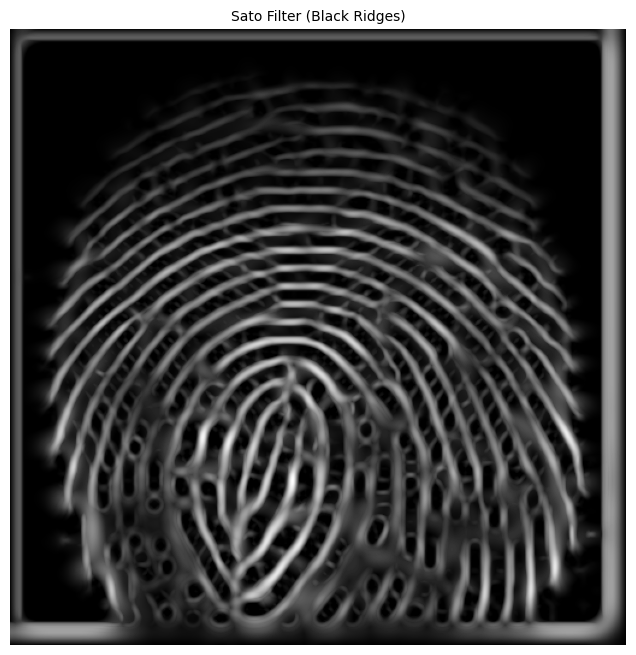

In [20]:
import cv2
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt
from skimage.transform import resize

# Loading your fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Resizing the image to reduce its size
resized_image = resize(fingerprint_image, (512, 512), anti_aliasing=True)

# Applying sato filter with black_ridges=True separately
sato_result = sato(resized_image, black_ridges=True)

# Displaying the sato_result separately
plt.figure(figsize=(8, 8))  # Adjust the figure size
plt.imshow(sato_result, cmap=plt.cm.gray)
plt.title("Sato Filter (Black Ridges)")
plt.axis('off')
plt.show()


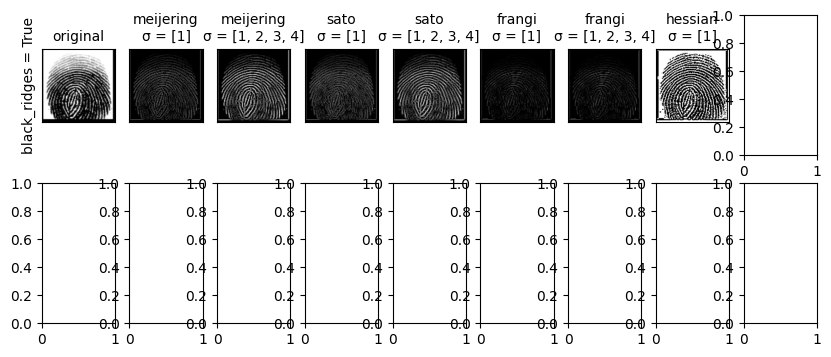

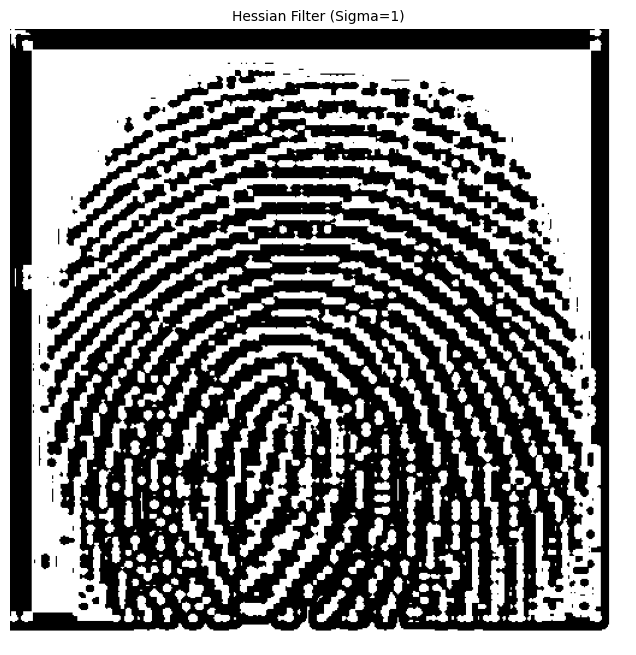

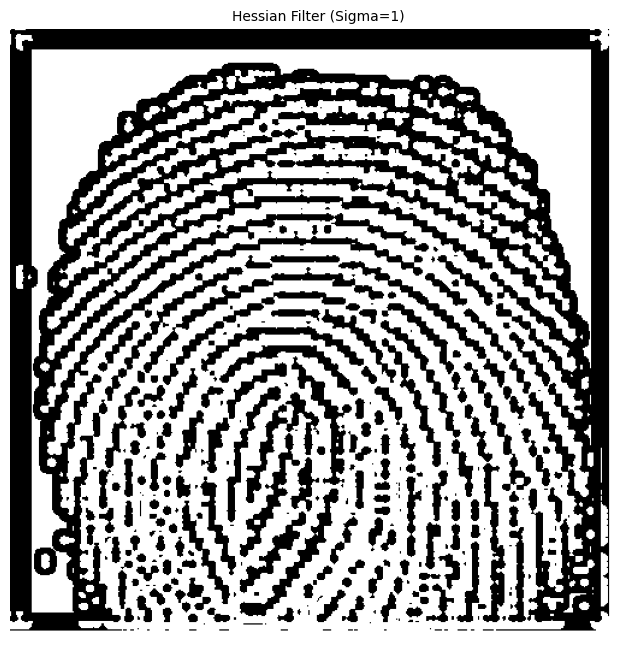

<Figure size 640x480 with 0 Axes>

In [25]:
import cv2
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt
from skimage.transform import resize

# Loading fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Resizing the image to reduce its size
resized_image = resize(fingerprint_image, (512, 512), anti_aliasing=True)

def original(image, **kwargs):
    """Return the original image, ignoring any kwargs."""
    return image

cmap = plt.cm.gray

plt.rcParams["axes.titlesize"] = "medium"
axes = plt.figure(figsize=(10, 4)).subplots(2, 9)
for i, black_ridges in enumerate([True, False]):
    for j, (func, sigmas) in enumerate([
            (original, None),
            (meijering, [1]),
            (meijering, range(1, 5)),
            (sato, [1]),
            (sato, range(1, 5)),
            (frangi, [1]),
            (frangi, range(1, 5)),
            (hessian, [1]),
            (hessian, range(1, 5)),
    ]):
        try:
            result = func(resized_image, black_ridges=black_ridges, sigmas=sigmas)
            axes[i, j].imshow(result, cmap=cmap)
            if i == 0:
                title = func.__name__
                if sigmas:
                    title += f"\n\N{GREEK SMALL LETTER SIGMA} = {list(sigmas)}"
                axes[i, j].set_title(title)
            if j == 0:
                axes[i, j].set_ylabel(f'{black_ridges = }')
            axes[i, j].set_xticks([])
            axes[i, j].set_yticks([])
            
            # Checking if it's hessian [1], and plot separately
            if func.__name__ == 'hessian' and sigmas == [1]:
                plt.figure(figsize=(8, 8))
                plt.imshow(result, cmap=cmap)
                plt.title("Hessian Filter (Sigma=1)")
                plt.axis('off')
                plt.show()
        except ValueError as e:
            print(f"Error: {e}")

plt.tight_layout()
plt.show()


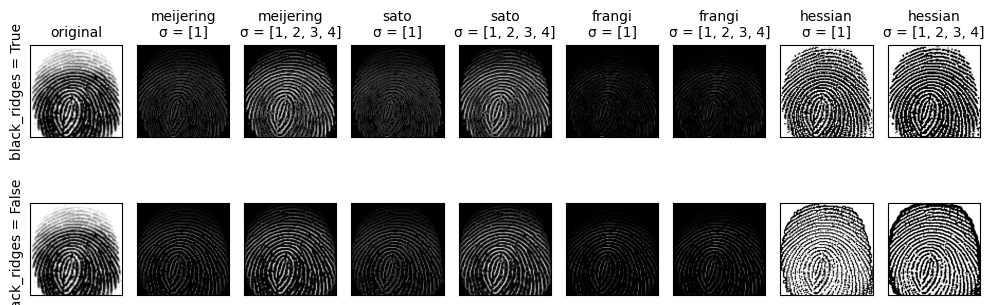

In [29]:
# Better strategy

import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
from skimage.transform import resize


# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image

normalized_image = cv2.normalize(cropped_image, None, alpha=100, beta=150, norm_type=cv2.NORM_MINMAX)


# Resizing the image to reduce its size
resized_image = resize(normalized_image, (512, 512), anti_aliasing=True)

def original(image, **kwargs):
    """Return the original image, ignoring any kwargs."""
    return image

cmap = plt.cm.gray

plt.rcParams["axes.titlesize"] = "medium"
axes = plt.figure(figsize=(10, 4)).subplots(2, 9)
for i, black_ridges in enumerate([True, False]):
    for j, (func, sigmas) in enumerate([
            (original, None),
            (meijering, [1]),
            (meijering, range(1, 5)),
            (sato, [1]),
            (sato, range(1, 5)),
            (frangi, [1]),
            (frangi, range(1, 5)),
            (hessian, [1]),
            (hessian, range(1, 5)),
    ]):
        try:
            result = func(resized_image, black_ridges=black_ridges, sigmas=sigmas)
            axes[i, j].imshow(result, cmap=cmap)
            if i == 0:
                title = func.__name__
                if sigmas:
                    title += f"\n\N{GREEK SMALL LETTER SIGMA} = {list(sigmas)}"
                axes[i, j].set_title(title)
            if j == 0:
                axes[i, j].set_ylabel(f'{black_ridges = }')
            axes[i, j].set_xticks([])
            axes[i, j].set_yticks([])
        except ValueError as e:
            print(f"Error: {e}")

plt.tight_layout()
plt.show()


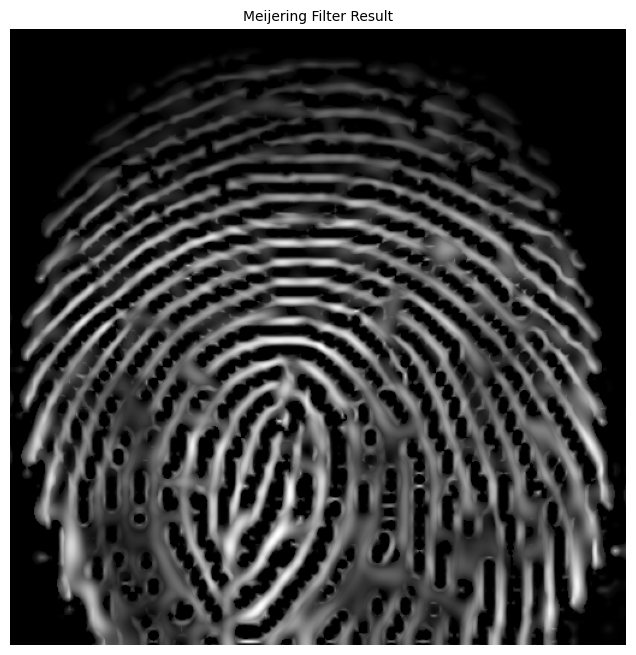

In [30]:
# Applying the Meijering filter
meijering_result = meijering(resized_image)

# Displaying the Meijering result in a separate window
plt.figure(figsize=(8, 8))
plt.imshow(meijering_result, cmap='gray')
plt.title('Meijering Filter Result')
plt.axis('off')
plt.show()

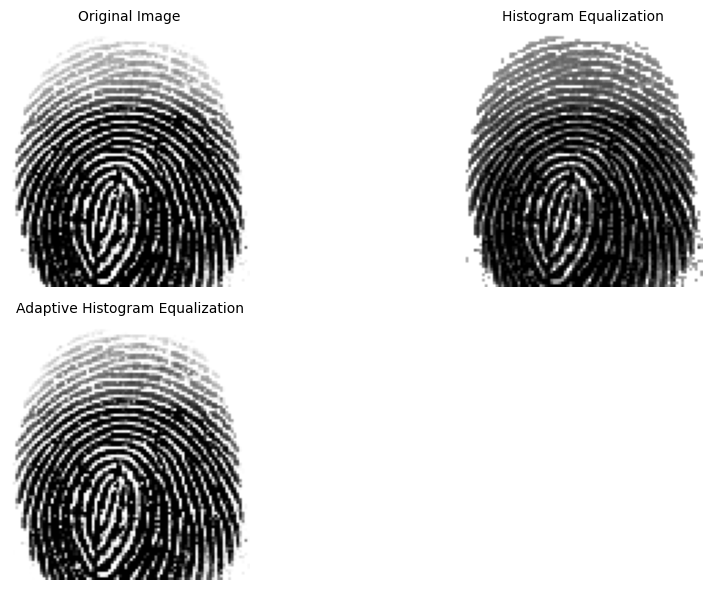

In [32]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying histogram equalization to enhance the image contrast
equalized_image = cv2.equalizeHist(normalized_image)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_image = clahe.apply(normalized_image)

# Displaying the original and enhanced images
plt.figure(figsize=(10, 6))

plt.subplot(2, 2, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(equalized_image, cmap='gray')
plt.title('Histogram Equalization')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(clahe_image, cmap='gray')
plt.title('Adaptive Histogram Equalization')
plt.axis('off')

plt.tight_layout()
plt.show()


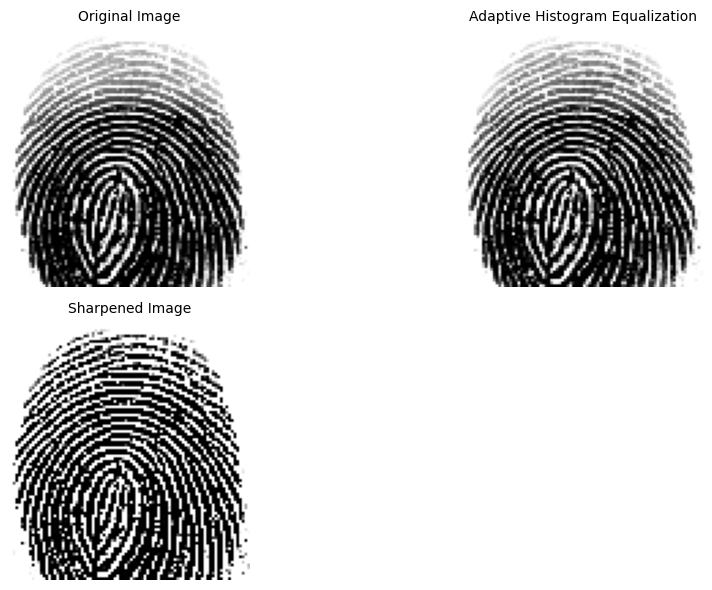

In [37]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_image = clahe.apply(normalized_image)

# Applying image sharpening to enhance the ridges
kernel = np.array([[-1, -1, -1],
                   [-1,  9, -1],
                   [-1, -1, -1]])
sharpened_image = cv2.filter2D(clahe_image, -1, kernel)

# Displaying the original and enhanced images
plt.figure(figsize=(10, 6))

plt.subplot(2, 2, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('Adaptive Histogram Equalization')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(sharpened_image, cmap='gray')
plt.title('Sharpened Image')
plt.axis('off')

plt.tight_layout()
plt.show()


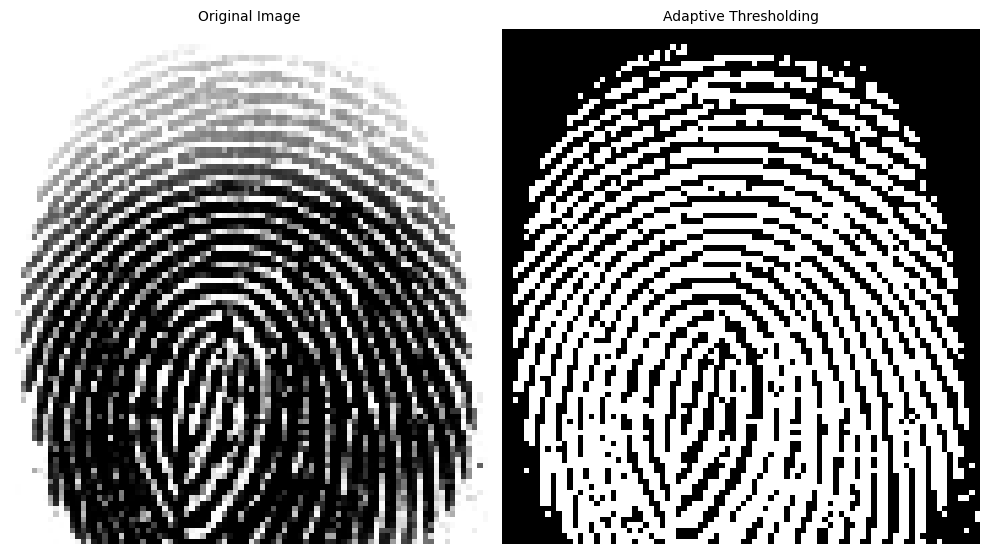

In [34]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\1__M_Left_index_finger.BMP"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying adaptive thresholding to enhance the ridges
adaptive_thresh = cv2.adaptiveThreshold(normalized_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)

# Displaying the original and enhanced images
plt.figure(figsize=(10, 6))

plt.subplot(1, 2, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(adaptive_thresh, cmap='gray')
plt.title('Adaptive Thresholding')
plt.axis('off')

plt.tight_layout()
plt.show()


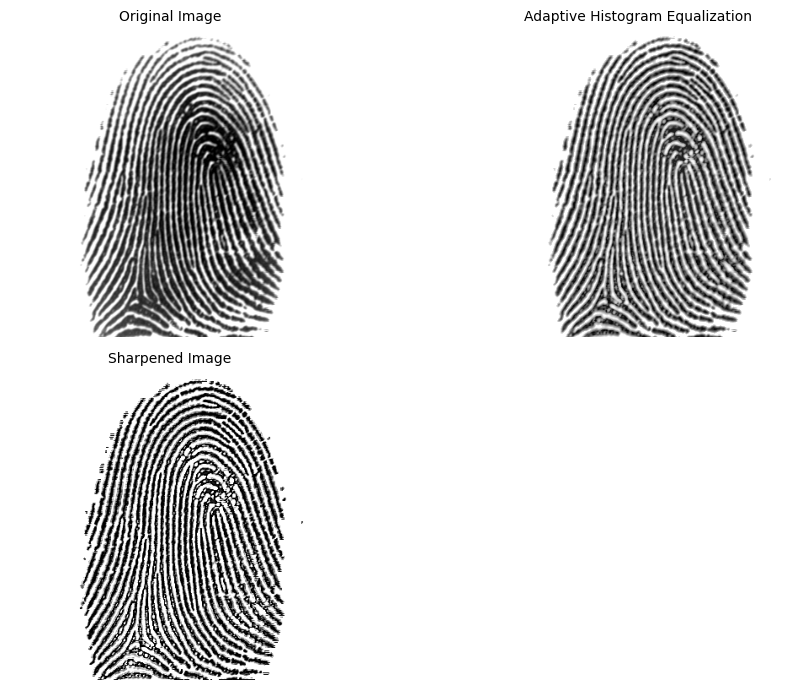

In [103]:
# Much much better strategy

import cv2
import numpy as np
import matplotlib.pyplot as plt

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(normalized_image)

# Applying image sharpening to enhance the ridges
kernel = np.array([[-1, -1, -1],
                   [-1,  9, -1],
                   [-1, -1, -1]])
sharpened_image = cv2.filter2D(clahe_image, -1, kernel)

# Displaying the original and enhanced images
plt.figure(figsize=(10, 7))

plt.subplot(2, 2, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('Adaptive Histogram Equalization')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(sharpened_image, cmap='gray')
plt.title('Sharpened Image')
plt.axis('off')

plt.tight_layout()
plt.show()


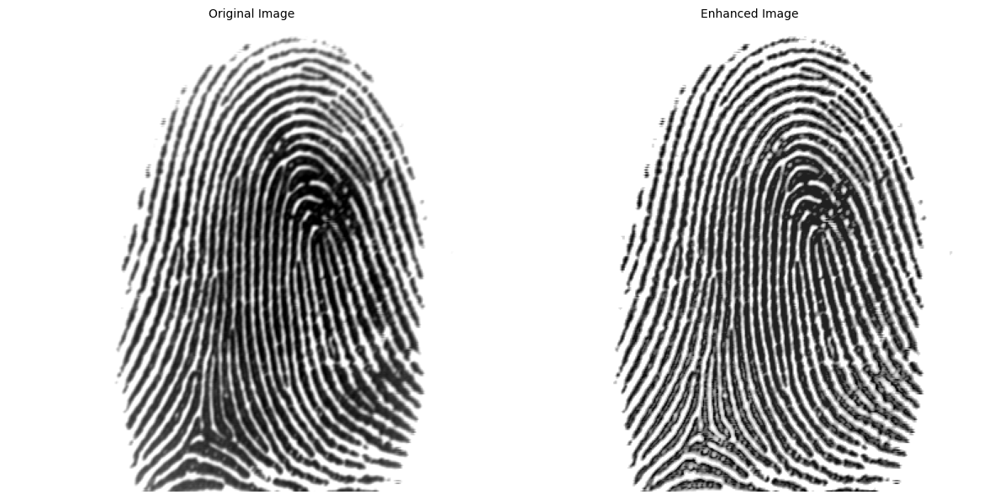

In [106]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure  # Import exposure module for rescale_intensity

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying contrast stretching
p1, p2 = np.percentile(normalized_image, (2, 98))
stretched_image = exposure.rescale_intensity(normalized_image, in_range=(p1, p2))

# Applying unsharp masking for sharpening
blurred_image = cv2.GaussianBlur(stretched_image, (5, 5), 0)
sharpness_factor = 1.5
sharpened_image = cv2.addWeighted(stretched_image, 1.0 + sharpness_factor, blurred_image, -sharpness_factor, 0)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(sharpened_image)

# Displaying the original and enhanced images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('Enhanced Image')
plt.axis('off')

plt.tight_layout()
plt.show()


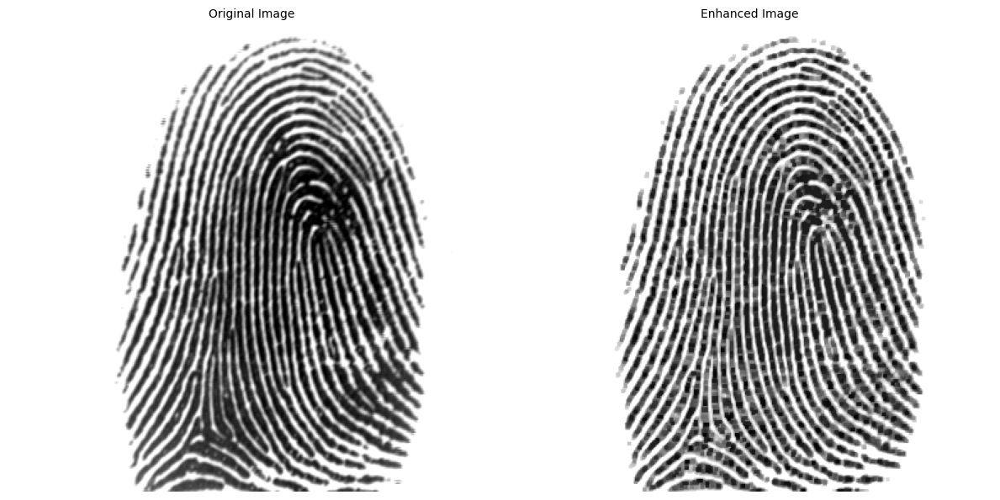

In [108]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying contrast stretching
p1, p2 = np.percentile(normalized_image, (2, 98))
stretched_image = exposure.rescale_intensity(normalized_image, in_range=(p1, p2))

# Applying unsharp masking for sharpening
blurred_image = cv2.GaussianBlur(stretched_image, (5, 5), 0)
sharpness_factor = 1.5
sharpened_image = cv2.addWeighted(stretched_image, 1.0 + sharpness_factor, blurred_image, -sharpness_factor, 0)

# Applying morphological operations to enhance ridge continuity
kernel = np.ones((3, 3), np.uint8)
morph_image = cv2.morphologyEx(sharpened_image, cv2.MORPH_CLOSE, kernel)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(morph_image)

# Displaying the original and enhanced images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('Enhanced Image')
plt.axis('off')

plt.tight_layout()
plt.show()


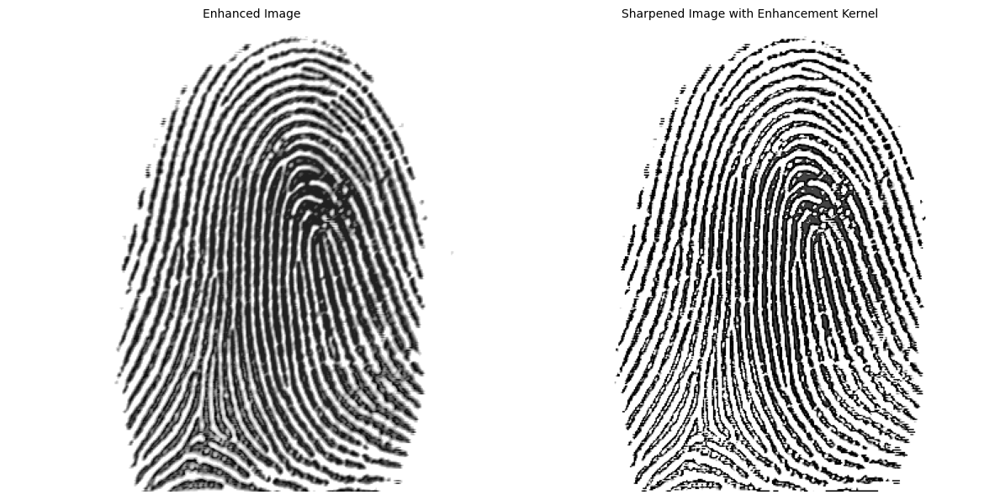

In [121]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure  # Import exposure module for rescale_intensity

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying contrast stretching
p1, p2 = np.percentile(normalized_image, (2, 98))
stretched_image = exposure.rescale_intensity(normalized_image, in_range=(p1, p2))

# Applying unsharp masking for sharpening
blurred_image = cv2.GaussianBlur(stretched_image, (5, 5), 0)
sharpness_factor = 1.5
sharpened_image = cv2.addWeighted(stretched_image, 1.0 + sharpness_factor, blurred_image, -sharpness_factor, 0)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(sharpened_image)

# Defining the sharpening kernel
sharpening_kernel = np.array([[0, -1, -1],
                               [-1, 9, -1],
                               [-1, -1, -1]])

# Applying the sharpening kernel
sharpened_with_kernel = cv2.filter2D(clahe_image, -1, sharpening_kernel)

# Displaying the original and sharpened images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(clahe_image, cmap='gray')
plt.title('Enhanced Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(sharpened_with_kernel, cmap='gray')
plt.title('Sharpened Image with Enhancement Kernel')
plt.axis('off')

plt.tight_layout()
plt.show()


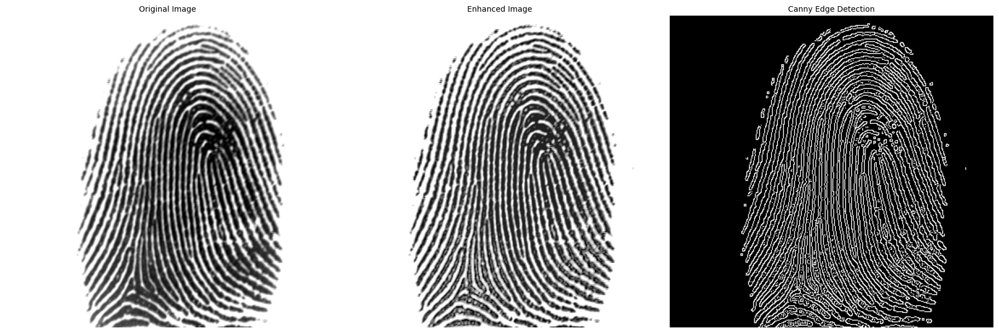

In [122]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure  # Import exposure module for rescale_intensity

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying contrast stretching
p1, p2 = np.percentile(normalized_image, (2, 98))
stretched_image = exposure.rescale_intensity(normalized_image, in_range=(p1, p2))

# Applying unsharp masking for sharpening
blurred_image = cv2.GaussianBlur(stretched_image, (5, 5), 0)
sharpness_factor = 1.5
sharpened_image = cv2.addWeighted(stretched_image, 1.0 + sharpness_factor, blurred_image, -sharpness_factor, 0)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(sharpened_image)

# Applying Canny edge detection
canny_edges = cv2.Canny(clahe_image, 50, 150)

# Displaying the original and enhanced images along with the detected edges
plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('Enhanced Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(canny_edges, cmap='gray')
plt.title('Canny Edge Detection')
plt.axis('off')

plt.tight_layout()
plt.show()


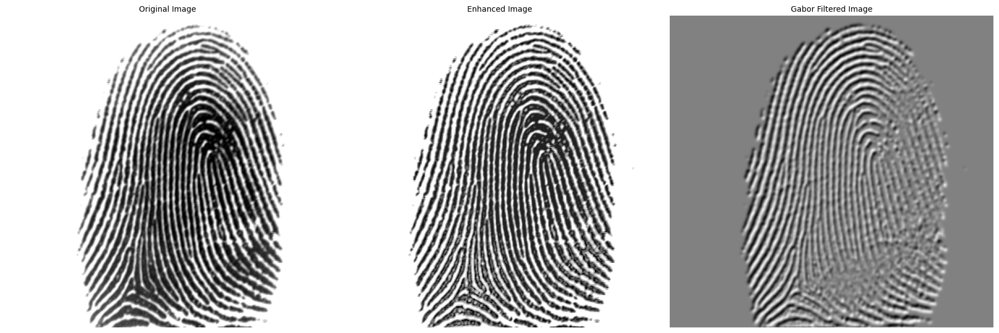

In [221]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure  # Import exposure module for rescale_intensity

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying contrast stretching
p1, p2 = np.percentile(normalized_image, (2, 98))
stretched_image = exposure.rescale_intensity(normalized_image, in_range=(p1, p2))

# Applying unsharp masking for sharpening
blurred_image = cv2.GaussianBlur(stretched_image, (5, 5), 0)
sharpness_factor = 1.5
sharpened_image = cv2.addWeighted(stretched_image, 1.0 + sharpness_factor, blurred_image, -sharpness_factor, 0)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(sharpened_image)

# Applying Gabor filter to enhance ridges
ksize = 20
theta = np.pi / 3
sigma = 2
lambda_ = 12
gamma = 1.5
gabor_kernel = cv2.getGaborKernel((ksize, ksize), sigma, theta, lambda_, gamma)
gabor_filtered_image = cv2.filter2D(clahe_image, cv2.CV_64F, gabor_kernel)

# Displaying the original and enhanced images along with the Gabor filtered image
plt.figure(figsize=(18, 6))

plt.subplot(1, 3, 1)
plt.imshow(normalized_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(clahe_image, cmap='gray')
plt.title('Enhanced Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(gabor_filtered_image, cmap='gray')
plt.title('Gabor Filtered Image')
plt.axis('off')

plt.tight_layout()
plt.show()


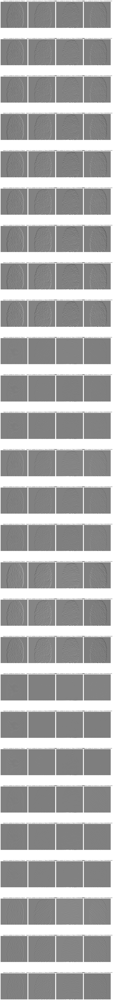

In [175]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure  # Import exposure module for rescale_intensity

# Loading the fingerprint image
image_path = "C:\\Users\\PREDATOR\\Desktop\\Data science fingerprint project\\SOCOFing\\Real\\103_1.tif"
fingerprint_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Calculating the number of pixels equivalent to 0.5mm (assuming 500 pixels per inch resolution)
pixels_per_mm = 500 / 25.4  # Assuming 500 pixels per inch
pixels_to_crop = int(0.25 * pixels_per_mm)

# Cropping the borders to remove 0.5mm from all sides
cropped_image = fingerprint_image[pixels_to_crop:-pixels_to_crop, pixels_to_crop:-pixels_to_crop]

# Normalizing the cropped image
normalized_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

# Applying contrast stretching
p1, p2 = np.percentile(normalized_image, (2, 98))
stretched_image = exposure.rescale_intensity(normalized_image, in_range=(p1, p2))

# Applying unsharp masking for sharpening
blurred_image = cv2.GaussianBlur(stretched_image, (5, 5), 0)
sharpness_factor = 1.5
sharpened_image = cv2.addWeighted(stretched_image, 1.0 + sharpness_factor, blurred_image, -sharpness_factor, 0)

# Applying adaptive histogram equalization to enhance the image contrast
clahe = cv2.createCLAHE(clipLimit=32.0, tileGridSize=(35, 35))
clahe_image = clahe.apply(sharpened_image)

# Defining parameters for Gabor filter
sigmas = [2.0, 4.0, 6.0]
lambdas = [8.0, 10.0, 12.0]
gammas = [0.5, 1.0, 1.5]
thetas = [0, np.pi/4, np.pi/2, 3*np.pi/4]

# Applying Gabor filter with multiple parameter combinations
results = []
for sigma in sigmas:
    for lambda_ in lambdas:
        for gamma in gammas:
            for theta in thetas:
                ksize = 31
                gabor_kernel = cv2.getGaborKernel((ksize, ksize), sigma, theta, lambda_, gamma)
                gabor_filtered_image = cv2.filter2D(clahe_image, cv2.CV_64F, gabor_kernel)
                results.append((sigma, lambda_, gamma, theta, gabor_filtered_image))

# Displaying images with different Gabor filter parameter combinations
num_images = len(results)
num_columns = 4
num_rows = (num_images + num_columns - 1) // num_columns

plt.figure(figsize=(18, 6 * num_rows))

for i, (sigma, lambda_, gamma, theta, gabor_filtered_image) in enumerate(results, start=1):
    plt.subplot(num_rows, num_columns, i)
    plt.imshow(gabor_filtered_image, cmap='gray')
    plt.title(f'Sigma={sigma}, Lambda={lambda_}, Gamma={gamma}, Theta={theta}')
    plt.axis('off')

plt.tight_layout()
plt.show()
